<a href="https://colab.research.google.com/github/ruthcfong/interactive_overlay/blob/master/geometric_transformations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [1]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [3]:
!pip install git+https://github.com/tensorflow/lucid.git
!npm install -g svelte-cli
!git clone https://github.com/ruthcfong/interactive_overlay.git

  Cloning https://github.com/tensorflow/lucid.git to /tmp/pip-req-build-ejp73c08
  Running command git clone -q https://github.com/tensorflow/lucid.git /tmp/pip-req-build-ejp73c08
     |████████████████████████████████| 14.6MB 183kB/s 
     |████████████████████████████████| 81kB 9.5MB/s 
     |████████████████████████████████| 1.1MB 39.2MB/s 
  Created wheel for lucid: filename=lucid-0.3.10-cp37-none-any.whl size=160375 sha256=520ca87bce6236a2d736d343f256c1020871774e5598a8e2e21dd3818f73e0c3
  Stored in directory: /tmp/pip-ephem-wheel-cache-0h5nel2u/wheels/64/c2/51/7238e75f457453774587708b21cd3cf32f9a86456648688634
  Created wheel for umap-learn: filename=umap_learn-0.5.1-cp37-none-any.whl size=76569 sha256=0d72cbc2e4eac84462105f9f72359c10eeb61f91940bec42cce152f88732af97
  Stored in directory: /root/.cache/pip/wheels/ad/df/d5/a3691296ff779f25cd1cf415a3af954b987fb53111e3392cf4
  Created wheel for pynndescent: filename=pynndescent-0.5.4-cp37-none-any.whl size=52374 sha256=bc1e2bfea44d8a9

/tools/node/bin/svelte -> /tools/node/lib/node_modules/svelte-cli/bin.js
+ svelte-cli@3.0.0
added 2 packages from 1 contributor in 1.347s
Cloning into 'interactive_overlay'...
remote: Enumerating objects: 65, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (50/50), done.
remote: Total 65 (delta 24), reused 50 (delta 12), pack-reused 0
Unpacking objects: 100% (65/65), done.


In [4]:
import os
import copy

import numpy as np
import tensorflow.compat.v1 as tf

import lucid.modelzoo.vision_models as models
from lucid.misc.io import load
from lucid.misc.io.showing import _image_url
import lucid.scratch.web.svelte as lucid_svelte

In [5]:
import interactive_overlay
from interactive_overlay.common import *
from interactive_overlay.utils_tensorflow import *

Trying to build svelte component from html...
svelte compile --format iife /tmp/svelte_so8j7bv0/CossimOverlay_b62cf93f_77af_4bdb_a13f_ab80d7192031.html > /tmp/svelte_so8j7bv0/CossimOverlay_b62cf93f_77af_4bdb_a13f_ab80d7192031.js
b'compiling ../tmp/svelte_so8j7bv0/CossimOverlay_b62cf93f_77af_4bdb_a13f_ab80d7192031.html...\n'
Trying to build svelte component from html...
svelte compile --format iife /tmp/svelte_so8j7bv0/CossimOverlayMulti_9321623c_9094_4536_8ff7_c3419a6262c1.html > /tmp/svelte_so8j7bv0/CossimOverlayMulti_9321623c_9094_4536_8ff7_c3419a6262c1.js
b'compiling ../tmp/svelte_so8j7bv0/CossimOverlayMulti_9321623c_9094_4536_8ff7_c3419a6262c1.html...\n'
Trying to build svelte component from html...
svelte compile --format iife /tmp/svelte_so8j7bv0/CossimOverlayMultiSeparate_0a2da464_2bc7_4c79_ace6_24029293a82d.html > /tmp/svelte_so8j7bv0/CossimOverlayMultiSeparate_0a2da464_2bc7_4c79_ace6_24029293a82d.js
b'compiling ../tmp/svelte_so8j7bv0/CossimOverlayMultiSeparate_0a2da464_2bc7_4c

# Definitions

In [6]:
model = models.InceptionV1()
model.load_graphdef()

In [7]:
dog_cat_path = "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/dog_cat.jpeg"

img_urls = ["https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/dog_cat.jpeg",
            "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/flowers.jpeg",
            "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/pig.jpeg",
            "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/bowtie_guy.jpeg",
            "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/beer.jpeg",
            "https://raw.githubusercontent.com/ruthcfong/interactive_overlay/master/images/chain.jpeg"]

# Functions

In [8]:
def vis_multi(imgs, acts, img_name=None, save_dir=None, titles=None, prefixes=None):
  grids = get_cossim_grids(acts)
  color_grids = add_color_index_multi(copy.deepcopy(grids), acts[0].shape[1], color_each=False)
  n_images = len(imgs)

  lucid_svelte.CossimOverlayMulti({
      "image_urls": [_image_url(img) for img in imgs],
      "masks_urls": [[_image_url(cossims_flat) for cossims_flat in row] for row in color_grids],
      "size": 224,
      "N": acts[0].shape[1],
      "n_images": n_images,
      "titles": titles,
  })

  if save_dir is not None:
    examples_dir = os.path.join(save_dir, 'examples')
    masks_dir = os.path.join(save_dir, 'masks')
    create_dir_if_necessary(save_dir)
    create_dir_if_necessary(examples_dir)
    create_dir_if_necessary(masks_dir)
    assert img_name is not None
    if prefixes is None:
      prefixes = ['' for _ in range(n_images)]
    assert prefixes is not None
    assert isinstance(prefixes, list)
    for i in range(n_images):
      save_img(imgs[i], os.path.join(examples_dir, '%s%s.png' % (img_name, prefixes[i])))
    
    for i in range(n_images):
      for j in range(n_images):
        save_img(color_grids[i][j], os.path.join(masks_dir, '%s%s%s.png' % (img_name, prefixes[i], prefixes[j])))

    return grids

In [9]:
def vis_multi_transform(model,
                        transform_name="rotate",
                        img_path=dog_cat_path,
                        num_imgs=4,
                        layer="mixed4d",
                        save_results=False,
                        min_value=None,
                        max_value=None,
                        mult_value=None,
                        blur_size=None):
  orig_img = load(img_path)
  img_name = get_image_name(img_path)

  if transform_name == "rotate":
    if max_value is None:
      max_value = 2*math.pi
    if mult_value is None:
      mult_value = -1
    get_acts_f = get_acts_rotate
  elif transform_name == "brightness":
    get_acts_f = get_acts_brightness
  elif transform_name == "contrast":
    get_acts_f = get_acts_contrast
  elif transform_name == "blur":
    if max_value is None:
      max_value = 20.
    get_acts_f = lambda x, y, z: get_acts_blur(x, y, z, blur_size=blur_size)
    raise ValueError("transform_name should be one of the following: "
                     "['rotate', 'brightness']. "
                     "Instead, it is %s." % transform_name)

  if min_value is None:
    min_value = 0
  if max_value is None:
    max_value = 1
  if mult_value is None:
    mult_value = 1.

  params = mult_value * np.linspace(min_value, max_value, num_imgs, endpoint=False).astype(np.float32)

  if transform_name == "rotate":
    degs = [mult_value*np.round(polar2degrees(p)) for p in params]
    titles = ["%d deg" % d for d in degs]
    prefixes = ["_%d" % d for d in degs]
  else:
    titles = None
    prefixes = None

  if save_results:
    save_dir = "transforms/%s" % transform_name
  else:
    save_dir = None
                              
  acts, imgs = [], []
  for i in range(num_imgs):
    act, img = get_acts_f(model,layer, orig_img, params[i])
    acts.append(act)
    imgs.append(img)
  
  grids = vis_multi(imgs, acts, img_name=img_name, save_dir=save_dir, titles=titles, prefixes=prefixes)

  if transform_name == "rotate":
    N = acts[0].shape[0]
    lines = np.zeros((num_imgs, num_imgs, N, N))
    for start_i in range(num_imgs):
      shifted_params = np.roll(params, start_i)
      for end_i in range(num_imgs):
        rot_angle = shifted_params[end_i]
        for y in range(N):
          for x in range(N):
            x_, y_ = get_rot_coords(x, y, rot_angle, N=N)
            x_, y_ = int(np.round(x_)), int(np.round(y_))
            if x_ < 0 or y_ < 0 or x_ >= N or y_ >= N:
              lines[start_i, end_i, y, x] = np.nan
            else:
              lines[start_i, end_i, y, x] = grids[start_i][end_i][y*N: y*N+N][:, x*N:x*N+N][y_, x_]
    if save_dir:
      lines_dir = os.path.join(save_dir, 'lines')
      if not os.path.exists(lines_dir):
        os.makedirs(lines_dir)

      prefixes = [int(-1 * np.round(polar2degrees(p))) for p in params]

      for i in range(lines.shape[0]):
        line_ = lines[i].reshape(lines.shape[1], -1).T
        save_path = os.path.join(lines_dir, '%s_%d.csv' % (img_name, prefixes[i]))
        np.savetxt(save_path, line_, fmt='%.2f')
  else:
    lines = None

  results = {
      'images': imgs, 
      'acts': acts,
      'grids': grids,
      'lines': lines,
      'params': params,
  }
  return results

In [10]:
def vis_multi_rotate(model, img_path=dog_cat_path, num_imgs=8, layer="mixed4d", save_results=False):
  vis_multi_transform(model=model,
                      transform_name="rotate",
                      img_path=img_path,
                      num_imgs=num_imgs,
                      layer=layer,
                      save_results=save_results)

In [16]:
def vis_multi_scale(model, img_path=dog_cat_path, num_imgs=8, layer="mixed4d", target=None, endpoint=True, target_name=None, save_results=False):
  orig_img = load(img_path)
  img_name = get_image_name(img_path)

  offset = 1
  if target is None:
    params = np.geomspace(0+offset, 1+offset, num_imgs, endpoint=endpoint)[::-1] - offset
  else:
    assert(len(target) == 4)
    params_y1 = np.geomspace(0+offset, target[0]+offset, num_imgs, endpoint=endpoint) - offset
    params_x1 = np.geomspace(0+offset, target[1]+offset, num_imgs, endpoint=endpoint) - offset
    params_y2 = np.geomspace(target[2], 1, num_imgs, endpoint=endpoint)[::-1]
    params_x2 = np.geomspace(target[3], 1, num_imgs, endpoint=endpoint)[::-1]
    params = np.array((params_y1, params_x1, params_y2, params_x2))
  acts, imgs = [], []
  for i in range(num_imgs):
    if target is None:
      box = [[0, 0, params[i], params[i]]]
    else:
      box = [[params_y1[i], params_x1[i], params_y2[i], params_x2[i]]]
    act, img = get_acts_scale(model,
                              layer,
                              orig_img,
                              box,
                              crop_size=[224, 224],
                              interpolation='nearest')
    acts.append(act)
    imgs.append(img)

  # Compute areas.
  y_diff = params[2] - params[0]
  x_diff = params[3] - params[1]
  areas = y_diff * x_diff
  zoom = (areas / areas[-1])[::-1]
  titles = ["%.1fx" % x for x in zoom]

  if save_results:
    save_dir = os.path.join('transforms/scale')
    if target_name is None:
      prefixes = ['_%d' % i for i in range(num_imgs)]
    else:
      assert isinstance(target_name, str)
      prefixes = ['_%s_%d' % (target_name, i) for i in range(num_imgs)]
  else:
    save_dir = None
    prefixes = None
  grids = vis_multi(imgs,
                    acts,
                    img_name=img_name,
                    save_dir=save_dir,
                    prefixes=prefixes,
                    titles=titles)

  # Compute data for line chart.
  N = acts[0].shape[0]
  lines = np.zeros((num_imgs, num_imgs, N, N))
  for start_i in range(num_imgs):
    curr_bbox = params[:,start_i]
    # shifted_params = np.roll(params, start_i)
    for end_i in range(num_imgs):
      # rot_angle = shifted_params[end_i]
      target_bbox = params[:,end_i]
      for y in range(N):
        for x in range(N):
          x_, y_ = get_scale_coords(x, y, N, curr_bbox, target_bbox)
          # x_, y_ = get_rot_coords(x, y, rot_angle, N=N)
          x_, y_ = int(np.round(x_)), int(np.round(y_))
          if x_ < 0 or y_ < 0 or x_ >= N or y_ >= N:
            lines[start_i, end_i, y, x] = np.nan
          else:
            lines[start_i, end_i, y, x] = grids[start_i][end_i][y*N: y*N+N][:, x*N:x*N+N][y_, x_]

  # Save data for line chart as csv files.
  if save_results:
    lines_dir = os.path.join(save_dir, 'lines')
    if not os.path.exists(lines_dir):
      os.makedirs(lines_dir)

    for i in range(lines.shape[0]):
      line_ = lines[i].reshape(lines.shape[1], -1).T
      save_path = os.path.join(lines_dir, '%s_%s.csv' % (img_name, prefixes[i]))
      np.savetxt(save_path, line_, fmt='%.2f', delimiter=',')

  results = {
      'images': imgs, 
      'acts': acts,
      'grids': grids,
      'lines': lines,
      'params': params,
      'areas': areas,
      'zoom': zoom,
  }
  return results

# Scale


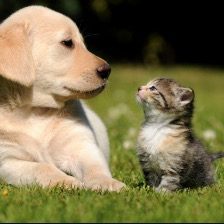
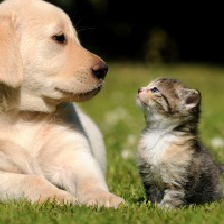
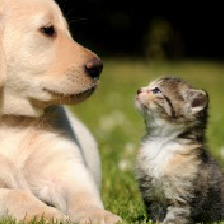
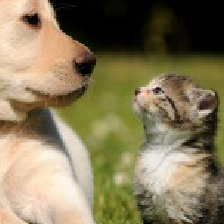
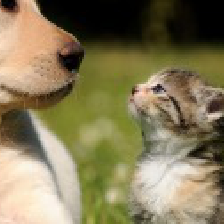
...
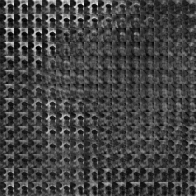
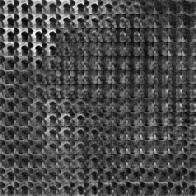
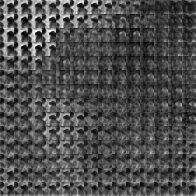
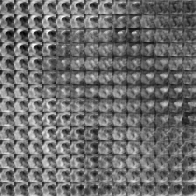
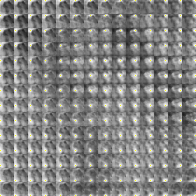

In [19]:
res = vis_multi_scale(model=model, img_path=dog_cat_path, num_imgs=8, layer="mixed4d", target=[ 0.35, 0.55, 0.55, 0.75], target_name="cat", save_results=True)


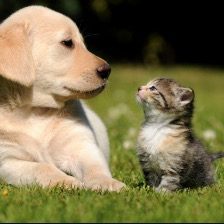
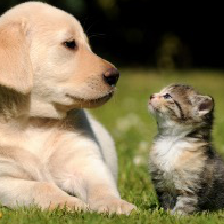
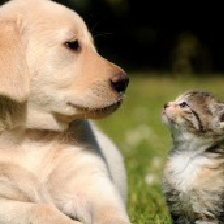
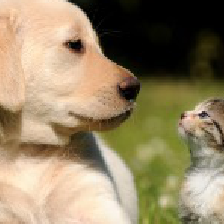
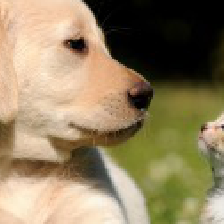
...
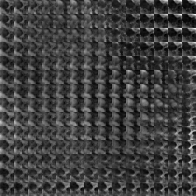
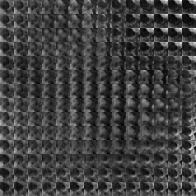
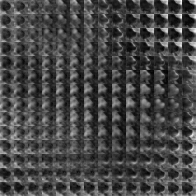
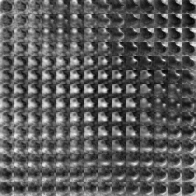
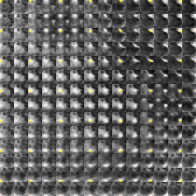

In [20]:
res = vis_multi_scale(model=model, img_path=dog_cat_path, num_imgs=8, layer="mixed4d", target=[ 0.15, 0.2, 0.45, 0.5], target_name="dog", save_results=True)

# Rotation


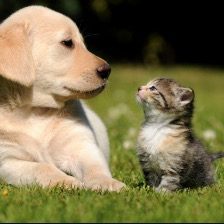
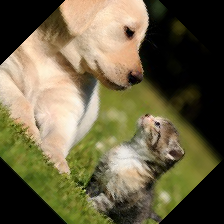
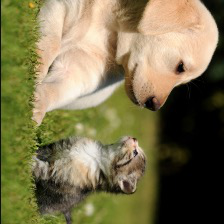
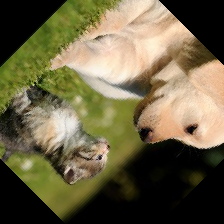
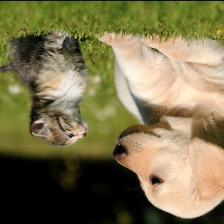
...
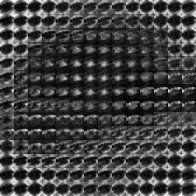
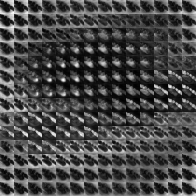
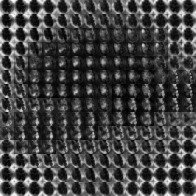
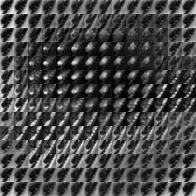
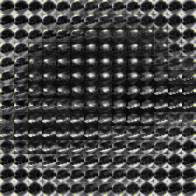

In [21]:
for img_url in img_urls:
  _ = vis_multi_transform(model=model, transform_name="rotate", img_path=img_url, num_imgs=8, layer="mixed4d", save_results=True)

# Line Plots

For interactive line plots, run the following line of code to compress all 
relevant information into a .zip folder.

Then, see source code for the interactive article and how to render it in JavaScript (the line plots use [Chart.js](https://www.chartjs.org/), which doesn't play nicely with Colab).

In [15]:
# Compress folder of images
!zip -r transforms.zip transforms

  adding: transforms/ (stored 0%)
  adding: transforms/rotate/ (stored 0%)
  adding: transforms/rotate/masks/ (stored 0%)
  adding: transforms/rotate/masks/flowers_90_315.png (deflated 2%)
  adding: transforms/rotate/masks/chain_0_270.png (deflated 3%)
  adding: transforms/rotate/masks/bowtie_guy_225_225.png (deflated 2%)
  adding: transforms/rotate/masks/pig_0_315.png (deflated 2%)
  adding: transforms/rotate/masks/beer_225_225.png (deflated 2%)
  adding: transforms/rotate/masks/flowers_45_270.png (deflated 1%)
  adding: transforms/rotate/masks/beer_180_0.png (deflated 1%)
  adding: transforms/rotate/masks/pig_0_0.png (deflated 1%)
  adding: transforms/rotate/masks/bowtie_guy_0_90.png (deflated 1%)
  adding: transforms/rotate/masks/chain_270_180.png (deflated 3%)
  adding: transforms/rotate/masks/chain_270_270.png (deflated 3%)
  adding: transforms/rotate/masks/flowers_180_0.png (deflated 2%)
  adding: transforms/rotate/masks/beer_180_315.png (deflated 2%)
  adding: transforms/rotate/